In [10]:
from tensorflow import keras

# path = "mushroom_model_EfficientNetV2B0_6.keras"  # straight quotes
# model = keras.models.load_model(path, compile=False, safe_mode=False)
# model.summary()


In [11]:
# from tensorflow import keras

# path = "mushroom_model_EfficientNetV2B0_4.keras"  # straight quotes
# model = keras.models.load_model(path, compile=True, safe_mode=True)
# model.summary()


In [12]:
from tensorflow import keras

path = "mushroom_model_EfficientNetV2B0_finetuned.keras"  # straight quotes
model = keras.models.load_model(path, compile=False, safe_mode=False)
model.summary()


Model: "sequential_10"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ efficientnetv2-b0 (Functional)  │ (None, 7, 7, 1280)     │     5,919,312 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ global_average_pooling2d_10     │ (None, 1280)           │             0 │
│ (GlobalAveragePooling2D)        │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_12 (Dense)                │ (None, 512)            │       655,872 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_11 (Dropout)            │ (None, 512)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_13 (Dense)                │ (None, 256)            │       131,328 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_12 (Dropout)            │ (None, 256)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_14 (Dense)                │ (None, 169)            │        43,433 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 6,749,945 (25.75 MB)

 Trainable params: 3,899,033 (14.87 MB)

 Non-trainable params: 2,850,912 (10.88 MB)

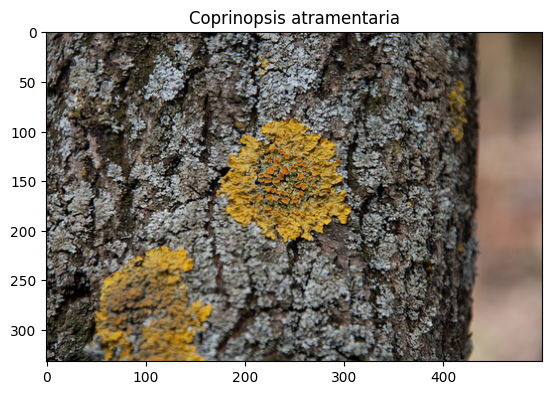

In [13]:
import pandas as pd
import os
from PIL import Image
import matplotlib.pyplot as plt
test = pd.read_csv('raw_data/test.csv')
test['image_path'] = test['image_path'].str.replace('/kaggle/working/merged_dataset/', '', regex=False)
base_path = 'raw_data/merged_dataset'
test['full_path'] = test['image_path'].apply(lambda x: os.path.join(base_path, x))
path = test.loc[0, 'full_path']
img = Image.open(path)
plt.imshow(img)
plt.title(test["label"].iloc[5])
plt.show()

In [14]:
3756/15614

0.2405533495580889

488/488 ━━━━━━━━━━━━━━━━━━━━ 157s 319ms/step
Classification Report:
                             precision    recall  f1-score   support

          Agaricus augustus       0.42      0.33      0.37        51
      Agaricus xanthodermus       0.41      0.28      0.33        46
     Amanita amerirubescens       0.75      0.12      0.21        50
            Amanita augusta       0.60      0.24      0.34        50
        Amanita brunnescens       0.40      0.50      0.44        46
      Amanita calyptroderma       0.60      0.57      0.58        49
            Amanita citrina       0.47      0.61      0.53        44
         Amanita flavoconia       0.70      0.40      0.51        48
           Amanita muscaria       0.86      0.96      0.91       687
         Amanita pantherina       0.56      0.27      0.37        51
          Amanita persicina       0.50      0.08      0.13        39
         Amanita phalloides       0.44      0.29      0.35        48
          Amanita rubescens       

/Users/ferdaousbouzaiene/.pyenv/versions/what-is-this-Mushroom/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1731: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", result.shape[0])
/Users/ferdaousbouzaiene/.pyenv/versions/what-is-this-Mushroom/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1731: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", result.shape[0])
/Users/ferdaousbouzaiene/.pyenv/versions/what-is-this-Mushroom/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1731: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_divi

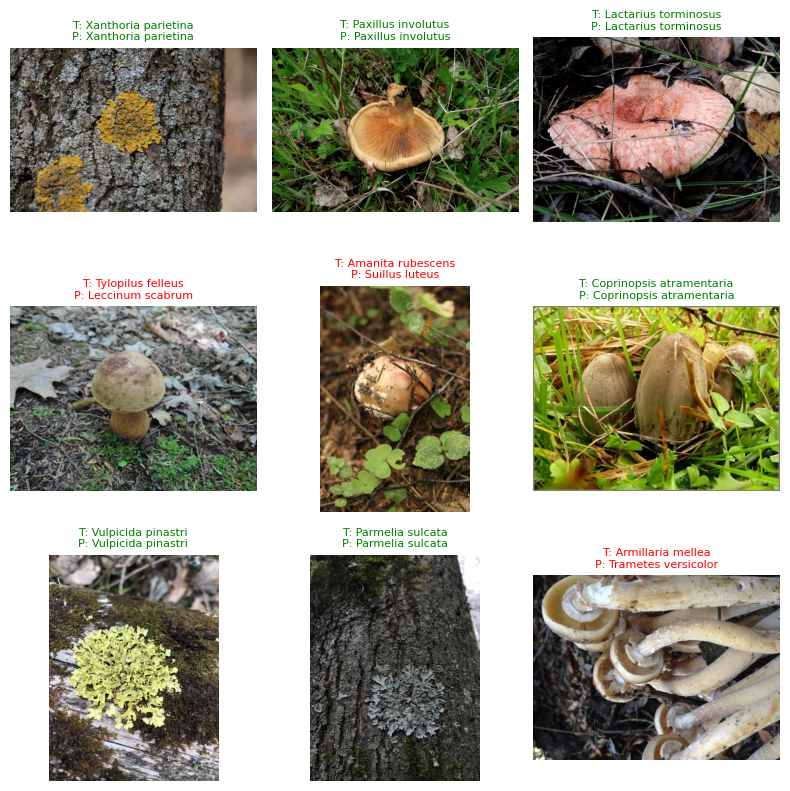

Saved 5078 misclassified samples to misclassified_test_samples.csv


In [15]:
import os

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from PIL import Image
from sklearn.metrics import classification_report, confusion_matrix

import tensorflow as tf


CONFIG = {
    "img_size": (224, 224),
    "batch_size": 32,
    "model_path": "mushroom_model_EfficientNetV2B0_4.keras",
    "output_csv": "misclassified_test_samples.csv"
}

# --- LOAD MODEL ---
model = tf.keras.models.load_model(CONFIG["model_path"], compile=False)

# --- LABEL MAPPING ---
unique_labels = sorted(test["label"].unique().tolist())
label2id = {lbl: i for i, lbl in enumerate(unique_labels)}
id2label = {i: lbl for lbl, i in label2id.items()}
test["label_id"] = test["label"].map(label2id)

# --- TF.DATA PIPELINE ---
def load_and_preprocess(path, label):
    img = tf.io.read_file(path)
    img = tf.image.decode_image(img, channels=3, expand_animations=False)
    img = tf.image.resize(img, CONFIG["img_size"])
    img = tf.keras.applications.efficientnet_v2.preprocess_input(img)
    return img, label

paths = test["full_path"].to_numpy()
labels = test["label_id"].to_numpy()

test_ds = tf.data.Dataset.from_tensor_slices((paths, labels))
test_ds = test_ds.map(load_and_preprocess, num_parallel_calls=tf.data.AUTOTUNE)
test_ds = test_ds.batch(CONFIG["batch_size"]).prefetch(tf.data.AUTOTUNE)


# --- PREDICTIONS ---
pred_probs = model.predict(test_ds, verbose=1)
pred_classes = np.argmax(pred_probs, axis=1)
true_classes = labels

# --- METRICS ---
print("Classification Report:")
print(classification_report(true_classes, pred_classes, target_names=[id2label[i] for i in range(len(id2label))]))

print("Confusion Matrix:")
print(confusion_matrix(true_classes, pred_classes))

accuracy = np.mean(true_classes == pred_classes)
print(f"Accuracy: {accuracy:.2%}")
print(f"Number of classes: {len(unique_labels)}")

# --- VISUALIZE PREDICTIONS ---
n = min(9, len(test))
plt.figure(figsize=(8, 8))
for i in range(n):
    path = test.loc[i, "full_path"]
    img = Image.open(path).convert("RGB")
    plt.subplot(3, 3, i + 1)
    plt.imshow(img)
    true_label = id2label[true_classes[i]]
    pred_label = id2label[pred_classes[i]]
    color = "green" if true_label == pred_label else "red"
    plt.title(f"T: {true_label}\nP: {pred_label}", fontsize=8, color=color)
    plt.axis("off")
plt.tight_layout()
plt.show()


# --- SAVE MISCLASSIFICATIONS ---
mis = test.copy()
mis["pred_id"] = pred_classes
mis["pred_label"] = mis["pred_id"].map(id2label)
mis["correct"] = mis["label_id"] == mis["pred_id"]
mis_wrong = mis[~mis["correct"]]
mis_wrong.to_csv(CONFIG["output_csv"], index=False)

print(f"Saved {len(mis_wrong)} misclassified samples to {CONFIG['output_csv']}")



488/488 ━━━━━━━━━━━━━━━━━━━━ 151s 307ms/step

✅ Accuracy: 67.48%
📦 Number of classes: 169

📊 Classification Report:
                             precision    recall  f1-score   support

          Agaricus augustus       0.42      0.33      0.37        51
      Agaricus xanthodermus       0.41      0.28      0.33        46
     Amanita amerirubescens       0.75      0.12      0.21        50
            Amanita augusta       0.60      0.24      0.34        50
        Amanita brunnescens       0.40      0.50      0.44        46
      Amanita calyptroderma       0.60      0.57      0.58        49
            Amanita citrina       0.47      0.61      0.53        44
         Amanita flavoconia       0.70      0.40      0.51        48
           Amanita muscaria       0.86      0.96      0.91       687
         Amanita pantherina       0.56      0.27      0.37        51
          Amanita persicina       0.50      0.08      0.13        39
         Amanita phalloides       0.44      0.29      0

/Users/ferdaousbouzaiene/.pyenv/versions/what-is-this-Mushroom/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1731: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", result.shape[0])
/Users/ferdaousbouzaiene/.pyenv/versions/what-is-this-Mushroom/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1731: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", result.shape[0])
/Users/ferdaousbouzaiene/.pyenv/versions/what-is-this-Mushroom/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1731: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_divi

ValueError: num must be an integer with 1 <= num <= 9, not 10

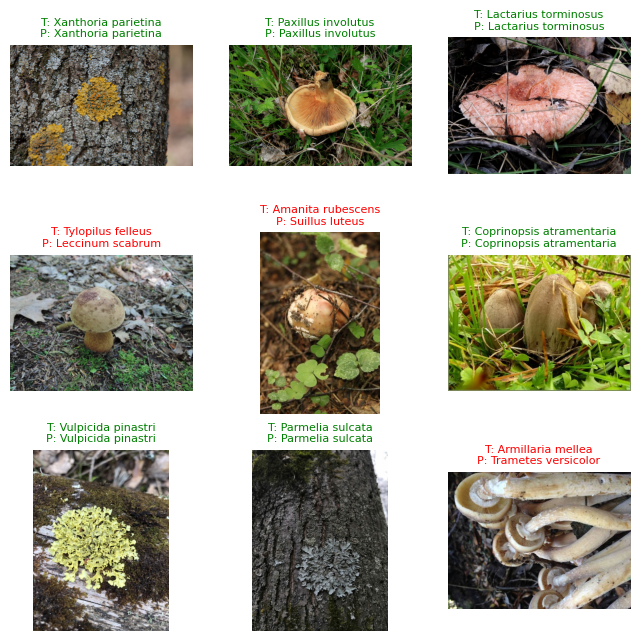

In [16]:
import os
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from PIL import Image
from sklearn.metrics import classification_report, confusion_matrix

import tensorflow as tf

# --- CONFIG ---
CONFIG = {
    "img_size": (224, 224),
    "batch_size": 32,
    "model_path": "mushroom_model_EfficientNetV2B0_4.keras",
    "output_csv": "misclassified_test_samples.csv",
    "n_visualize": 90  # number of predictions to visualize
}

# --- Load model ---
model = tf.keras.models.load_model(CONFIG["model_path"], compile=False)

# --- Prepare test data ---
unique_labels = sorted(test["label"].unique())
label2id = {label: idx for idx, label in enumerate(unique_labels)}
id2label = {idx: label for label, idx in label2id.items()}

test["label_id"] = test["label"].map(label2id)
paths = test["full_path"].values
labels = test["label_id"].values

def preprocess_image(path, label):
    img = tf.io.read_file(path)
    img = tf.image.decode_image(img, channels=3, expand_animations=False)
    img = tf.image.resize(img, CONFIG["img_size"])
    img = tf.keras.applications.efficientnet_v2.preprocess_input(img)
    return img, label

test_ds = tf.data.Dataset.from_tensor_slices((paths, labels))
test_ds = test_ds.map(preprocess_image, num_parallel_calls=tf.data.AUTOTUNE)
test_ds = test_ds.batch(CONFIG["batch_size"]).prefetch(tf.data.AUTOTUNE)

# --- Run predictions ---
pred_probs = model.predict(test_ds, verbose=1)
pred_classes = np.argmax(pred_probs, axis=1)

# --- Evaluation ---
true_classes = labels
accuracy = np.mean(true_classes == pred_classes)
print(f"\n✅ Accuracy: {accuracy:.2%}")
print(f"📦 Number of classes: {len(unique_labels)}")

print("\n📊 Classification Report:")
print(classification_report(true_classes, pred_classes, target_names=unique_labels))

print("\n🧮 Confusion Matrix:")
print(confusion_matrix(true_classes, pred_classes))

# --- Visualize Predictions ---
n = min(CONFIG["n_visualize"], len(test))
plt.figure(figsize=(8, 8))

for i in range(n):
    row = test.iloc[i]
    img = Image.open(row["full_path"]).convert("RGB")

    true_label = id2label[true_classes[i]]
    pred_label = id2label[pred_classes[i]]
    color = "green" if true_label == pred_label else "red"

    plt.subplot(3, 3, i + 1)
    plt.imshow(img)
    plt.title(f"T: {true_label}\nP: {pred_label}", fontsize=8, color=color)
    plt.axis("off")

plt.tight_layout()
plt.show()

# --- Save misclassified samples ---
test["pred_id"] = pred_classes
test["pred_label"] = test["pred_id"].map(id2label)
test["correct"] = test["label_id"] == test["pred_id"]

misclassified = test[~test["correct"]]
misclassified.to_csv(CONFIG["output_csv"], index=False)

print(f"\n❌ Misclassified samples: {len(misclassified)}")
print(f"💾 Saved to: {CONFIG['output_csv']}")


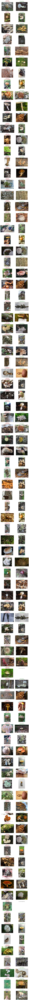

In [ ]:
# --- Visualize Misclassifications: wrong image vs. correct example ---
# Build convenience columns first (you already do this later; keeping here
# too so the viz works even if this block runs earlier)
test["pred_id"] = pred_classes
test["pred_label"] = test["pred_id"].map(id2label)
test["correct"] = test["label_id"] == test["pred_id"]

misclassified = test[~test["correct"]].copy()
correct = test[test["correct"]].copy()

if len(misclassified) == 0:
    print("\n🎉 No misclassifications to show!")
else:
    # Make a pool of correctly predicted examples per true class
    correct_pool = {
        lbl: df_lbl["full_path"].tolist()
        for lbl, df_lbl in correct.groupby("label_id")
    }

    n = min(CONFIG["n_visualize"], len(misclassified))
    plt.figure(figsize=(8, 3 * n))

    for i, (_, row) in enumerate(misclassified.head(n).iterrows()):
        true_lbl_id = row["label_id"]
        true_lbl = id2label[true_lbl_id]
        pred_lbl = id2label[row["pred_id"]]

        # Left: the misclassified image
        ax_left = plt.subplot(n, 2, 2 * i + 1)
        img_wrong = Image.open(row["full_path"]).convert("RGB")
        ax_left.imshow(img_wrong)
        ax_left.set_title(f"Misclassified\nT: {true_lbl}\nP: {pred_lbl}", fontsize=9, color="red")
        ax_left.axis("off")

        # Right: a correctly predicted example from the *true* class
        ax_right = plt.subplot(n, 2, 2 * i + 2)
        ref_path = None
        if true_lbl_id in correct_pool and len(correct_pool[true_lbl_id]) > 0:
            # just take the first; could randomize if you want
            ref_path = correct_pool[true_lbl_id][0]

        if ref_path is not None:
            img_right = Image.open(ref_path).convert("RGB")
            ax_right.imshow(img_right)
            ax_right.set_title(f"Correct example\nT=P: {true_lbl}", fontsize=9, color="green")
            ax_right.axis("off")
        else:
            ax_right.axis("off")
            ax_right.set_title("No correct example found", fontsize=9)

    plt.tight_layout()
    plt.show()
